# Worksheet Audio
Nama : M. Arief Rahman Hakim\
NIM  : 122140083


## Soal 1 : Rekaman dan Analisis Suara Multi-Level

Rekamlah suara Anda sendiri selama 25 detik dimana Anda membaca sebuah teks
berita.

Dalam 25 detik rekaman tersebut, Anda harus merekam:
- 5 detik pertama: suara sangat pelan dan berbisik
- 5 detik kedua: suara normal
- 5 detik ketiga: suara keras
- 5 detik keempat: suara cempreng (dibuat-buat cempreng)
- 5 detik terakhir: suara berteriak
 
Rekam dalam format WAV (atau konversikan ke WAV sebelum dimuat ke notebook).

## Soal 2: Noise Reduction dengan Filtering
Rekam suara Anda berbicara di sekitar objek yang berisik (seperti kipas angin, AC,
atau mesin).
- Rekaman tersebut harus berdurasi kurang lebih 10 detik.
- Rekam dalam format WAV (atau konversikan ke WAV sebelum dimuat ke notebook).

> Gunakan filter equalisasi (high-pass, low-pass, dan band-pass) untuk menghilangkan
noise pada rekaman tersebut.

> Lakukan eksperimen dengan berbagai nilai frekuensi cutoff (misalnya 500 Hz, 1000
Hz, 2000 Hz).

> Visualisasikan hasil dari tiap filter dan bandingkan spektrogramnya. Jelaskan:
-  Jenis noise yang muncul pada rekaman Anda
-  Filter mana yang paling efektif untuk mengurangi noise tersebut
-  Nilai cutoff yang memberikan hasil terbaik
-  Bagaimana kualitas suara (kejelasan ucapan) setelah proses filtering

In [1]:
# Import audio
from IPython.display import Audio
import os

# Ambil path audio
PATH_AUDIO = os.path.join(os.getcwd(), 'data', 'Rekaman Depan Kipas Angin.wav')

# Play audio
Audio(PATH_AUDIO)


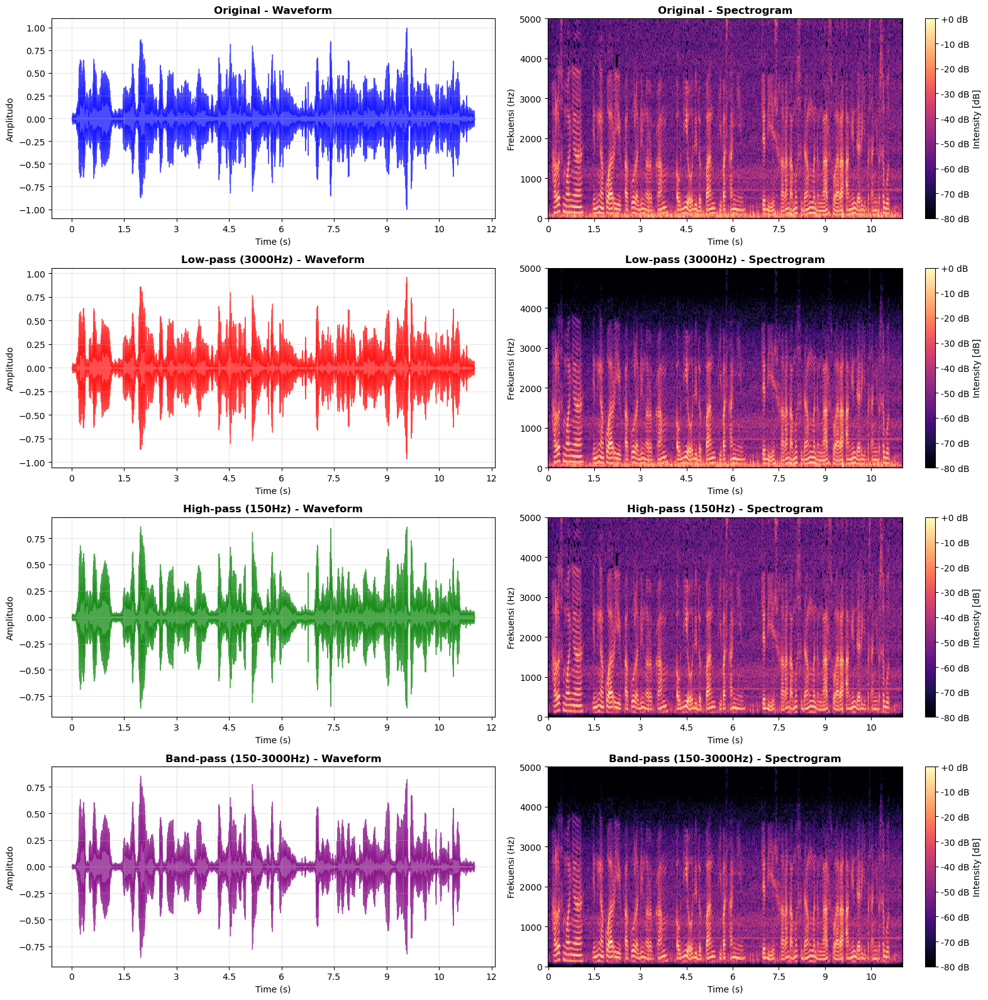

Original Audio


Lowpass Filtered Audio


Highpass Filtered Audio


Bandpass Filtered Audio


In [11]:
import matplotlib.pyplot as plt
from scipy.signal import spectrogram
from scipy.io import wavfile
from scipy.signal import butter, filtfilt
import scipy.signal
import numpy as np
from IPython.display import Audio
import librosa

# Sample Rate and Data
rate, data = wavfile.read(PATH_AUDIO)
data = data / np.max(np.abs(data))  # Normalisasi data

# Lowpass Filter
cutoff_low = 3000  # Hz
filter_order = 4
nyquist = 0.5 * rate
normal_cutoff_low = cutoff_low / nyquist
b_low, a_low = butter(filter_order, normal_cutoff_low, btype='low')
audio_lowpass = filtfilt(b_low, a_low, data)

# Highpass Filter
cutoff_high = 150  # Hz
filter_order = 4
nyquist = 0.5 * rate
normal_cutoff_high = cutoff_high / nyquist
b_high, a_high = butter(filter_order, normal_cutoff_high, btype='high')
audio_highpass = filtfilt(b_high, a_high, data)

# Parameter Filter untuk Bandpass
bandpass_low = 150   # Hz
bandpass_high = 3000 # Hz
filter_order = 4
nyquist = 0.5 * rate
bandpass_normalized = [bandpass_low / nyquist, bandpass_high / nyquist]
b_band, a_band = scipy.signal.butter(filter_order, bandpass_normalized, btype='band')
audio_bandpass = scipy.signal.filtfilt(b_band, a_band, data)


# Visualisasi Perbandingan
import librosa.display

fig, axes = plt.subplots(4, 2, figsize=(16, 16))

# Function untuk plot spectrogram menggunakan librosa
def plot_audio_spectrum(audio, sr, ax_wave, ax_spec, title, color):
    # Waveform
    librosa.display.waveshow(audio, sr=sr, ax=ax_wave, color=color, alpha=0.7)
    ax_wave.set_title(f'{title} - Waveform', fontweight='bold')
    ax_wave.set_ylabel('Amplitudo')
    ax_wave.set_xlabel('Time (s)')
    ax_wave.grid(True, alpha=0.3)
    
    # Spectrogram menggunakan librosa
    S = librosa.stft(audio)
    S_db = librosa.amplitude_to_db(np.abs(S), ref=np.max)
    img = librosa.display.specshow(S_db, sr=sr, x_axis='time', y_axis='hz', ax=ax_spec)
    ax_spec.set_title(f'{title} - Spectrogram', fontweight='bold')
    ax_spec.set_ylabel('Frekuensi (Hz)')
    ax_spec.set_xlabel('Time (s)')
    ax_spec.set_ylim(0, 5000)
    plt.colorbar(img, ax=ax_spec, format='%+2.0f dB', label='Intensity [dB]')

# Plot semua audio
plot_audio_spectrum(data, rate, axes[0,0], axes[0,1], 'Original', 'blue')
plot_audio_spectrum(audio_lowpass, rate, axes[1,0], axes[1,1], f'Low-pass ({cutoff_low}Hz)', 'red')
plot_audio_spectrum(audio_highpass, rate, axes[2,0], axes[2,1], f'High-pass ({cutoff_high}Hz)', 'green')
plot_audio_spectrum(audio_bandpass, rate, axes[3,0], axes[3,1], f'Band-pass ({bandpass_low}-{bandpass_high}Hz)', 'purple')

plt.tight_layout()
plt.show()


# Play original and filtered audio
print("Original Audio")
display(Audio(data, rate=rate))

print("Lowpass Filtered Audio")
display(Audio(audio_lowpass, rate=rate))

print("Highpass Filtered Audio")
display(Audio(audio_highpass, rate=rate))

print("Bandpass Filtered Audio")
display(Audio(audio_bandpass, rate=rate))



Penjelasan:


## Soal 3: Pitch Shifting dan Audio Manipulation

Lakukan pitch shifting pada rekaman suara Soal 1 untuk membuat suara terdengar
seperti chipmunk (dengan mengubah pitch ke atas).

- Visualisasikan waveform dan spektrogram sebelum dan sesudah pitch shifting.
• Jelaskan proses pitch shifting yang Anda lakukan, termasuk:
- Parameter yang digunakan
- Perbedaan dalam representasi visual antara suara asli dan suara yang telah dimodifikasi
- Bagaimana perubahan pitch memengaruhi kualitas dan kejelasan suara

- Gunakan dua buah pitch tinggi, misalnya pitch +7 dan pitch +12.
- Gabungkan kedua rekaman yang telah di-pitch shift ke dalam satu file audio. (Gunakan ChatGPT / AI untuk membantu Anda dalam proses ini)


## Soal 4: Audio Processing Chain

> Lakukan processing pada rekaman yang sudah di-pitch shift pada Soal 3 dengan
tahapan:
- Equalizer
- Gain/fade
- Normalization
- Compression
- Noise Gate
- Silence trimming


> Atur nilai target loudness ke -16 LUFS.

> Visualisasikan waveform dan spektrogram sebelum dan sesudah proses normalisasi.Jelaskan:
-  Perubahan dinamika suara yang terjadi
-  Perbedaan antara normalisasi peak dan normalisasi LUFS
-  Bagaimana kualitas suara berubah setelah proses normalisasi dan loudness optimization
- Kelebihan dan kekurangan dari pengoptimalan loudness dalam konteks rekaman suara


## Soal 5: Music Analysis dan Remix


> Pilih 2 buah (potongan) lagu yang memiliki vokal (penyanyi) dan berdurasi sekitar 1 menit:
-  Lagu 1: Nuansa sedih, lambat
-  Lagu 2: Nuansa ceria, cepat
> Konversikan ke format WAV sebelum dimuat ke notebook.

>  Lakukan deteksi tempo (BPM) dan estimasi kunci (key) dari masing-masing lagu dan berikan analisis singkat. 

>  Lakukan remix terhadap kedua lagu:

-  Time Stretch: Samakan tempo kedua lagu
-  Pitch Shift: Samakan kunci (key) kedua lagu
-  Crossfading: Gabungkan kedua lagu dengan efek crossfading
-  Filter Tambahan: Tambahkan filter kreatif sesuai keinginan (opsional)

>  Jelaskan proses dan parameter yang digunakan.

>  Tampilkan waveform dan spektrogram sesudah remix.

>  Jelaskan hasil remix yang telah dilakukan.

In [ ]:
import matplotlib.pyplot as plt
from scipy.signal import spectrogram
import scipy.signal
import numpy as np
from IPython.display import Audio
import librosa

# Ambil Path Lagu 1 dan Lagu 2
PATH_LAGU1 = os.path.join(os.getcwd(), 'data', 'Lagu 1.wav')
PATH_LAGU2 = os.path.join(os.getcwd(), 'data', 'Lagu 2.wav')

# Define start and end times for cutting
start_time_lagu1 = 12  # detik
end_time_lagu1 = 90    # detik

start_time_lagu2 = 21  # detik
end_time_lagu2 = 88    # detik

# Ambil Potong Lagu 1 pada detik ke 12 sampai ke detik 90
data1, rate1 = librosa.load(PATH_LAGU1, sr=None)
data1_cut = data1[int(start_time_lagu1 * rate1):int(end_time_lagu1 * rate1)]
print(f"Sample Rate Lagu 1: {rate1} Hz, Durasi: {len(data1)/rate1:.2f} detik")

# Play Potong Lagu 1
print("Potong Lagu 1 (12s - 90s)")
display(Audio(data1_cut, rate=rate1))

# Ambil Potong Lagu 2 pada detik ke 21 sampai ke detik 88
data2, rate2 = librosa.load(PATH_LAGU2, sr=None)
data2_cut = data2[int(start_time_lagu2 * rate2):int(end_time_lagu2 * rate2)]
print(f"Sample Rate Lagu 2: {rate2} Hz, Durasi: {len(data2)/rate2:.2f} detik")

# Play Potong Lagu 2
print("Potong Lagu 2 (32s - 88s)")
display(Audio(data2_cut, rate=rate2))

 

Sample Rate Lagu 1: 48000 Hz, Durasi: 244.99 detik
Potong Lagu 1 (12s - 90s)


Sample Rate Lagu 2: 48000 Hz, Durasi: 221.46 detik
Potong Lagu 2 (32s - 88s)


In [16]:
# Lakukan deteksi tempo (BPM) dan estimasi kunci (key) dari Lagu 1
import librosa

# Lagu 1: Deteksi tempo dan beat
tempo1, beats1 = librosa.beat.beat_track(y=data1_cut, sr=rate1)
print(f"HASIL DETEKSI TEMPO dan BEAT")
print(f"LAGU 1")
print(f"• BPM Terdeteksi: {tempo1[0]:.1f} BPM")
print(f"• Jumlah beat: {len(beats1)} beats")
print(f"• Durasi audio: {len(data1_cut)/rate1:.2f} detik")
print()

# Lagu 2: Deteksi tempo dan beat
tempo2, beats2 = librosa.beat.beat_track(y=data2_cut, sr=rate2)
print(f"LAGU 2")
print(f"• BPM Terdeteksi: {tempo2[0]:.1f} BPM")
print(f"• Jumlah beat: {len(beats2)} beats")
print(f"• Durasi audio: {len(data2_cut)/rate2:.2f} detik")
print()

# Lakukan konversi beat ke dalam detik untuk lagu 1 dan lagu 2
beats1_time = librosa.frames_to_time(beats1, sr=rate1)
beats2_time = librosa.frames_to_time(beats2, sr=rate2)

# Hitung interval antar beat untuk analisis konsistensi
# Lagu 1
beat_intervals1 = np.diff(beats1_time)
avg_interval1 = np.mean(beat_intervals1)
interval_std1 = np.std(beat_intervals1)
stability_score1 = 1 - (interval_std1 / avg_interval1)

print(f"ANALISIS KONSISTENSI TEMPO")

print(f"LAGU 1")
print(f"• Rata-rata interval beat: {avg_interval1:.3f} detik")
print(f"• Standar deviasi interval: {interval_std1:.3f} detik")
print(f"• Konsistensi tempo: {100 - (interval_std1/avg_interval1)*100:.1f}%")
print(f"• Skor Stabilitas: {stability_score1:.2f} ({stability_score1*100:.1f}%)")
print()

# Lagu 2
beat_intervals2 = np.diff(beats2_time)
avg_interval2 = np.mean(beat_intervals2)
interval_std2 = np.std(beat_intervals2)
stability_score2 = 1 - (interval_std2 / avg_interval2)

print(f"LAGU 2")
print(f"• Rata-rata interval beat: {avg_interval2:.3f} detik")
print(f"• Standar deviasi interval: {interval_std2:.3f} detik")
print(f"• Konsistensi tempo: {100 - (interval_std2/avg_interval2)*100:.1f}%")
print(f"• Skor Stabilitas: {stability_score2:.2f} ({stability_score2*100:.1f}%)")


HASIL DETEKSI TEMPO dan BEAT
LAGU 1
• BPM Terdeteksi: 160.7 BPM
• Jumlah beat: 175 beats
• Durasi audio: 78.00 detik

LAGU 2
• BPM Terdeteksi: 117.2 BPM
• Jumlah beat: 126 beats
• Durasi audio: 67.00 detik

ANALISIS KONSISTENSI TEMPO
LAGU 1
• Rata-rata interval beat: 0.376 detik
• Standar deviasi interval: 0.016 detik
• Konsistensi tempo: 95.7%
• Skor Stabilitas: 0.96 (95.7%)

LAGU 2
• Rata-rata interval beat: 0.521 detik
• Standar deviasi interval: 0.053 detik
• Konsistensi tempo: 89.8%
• Skor Stabilitas: 0.90 (89.8%)


C:\Users\qwert\AppData\Local\Temp\ipykernel_21296\3669400390.py:83: UserWarning: Glyph 127925 (\N{MUSICAL NOTE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


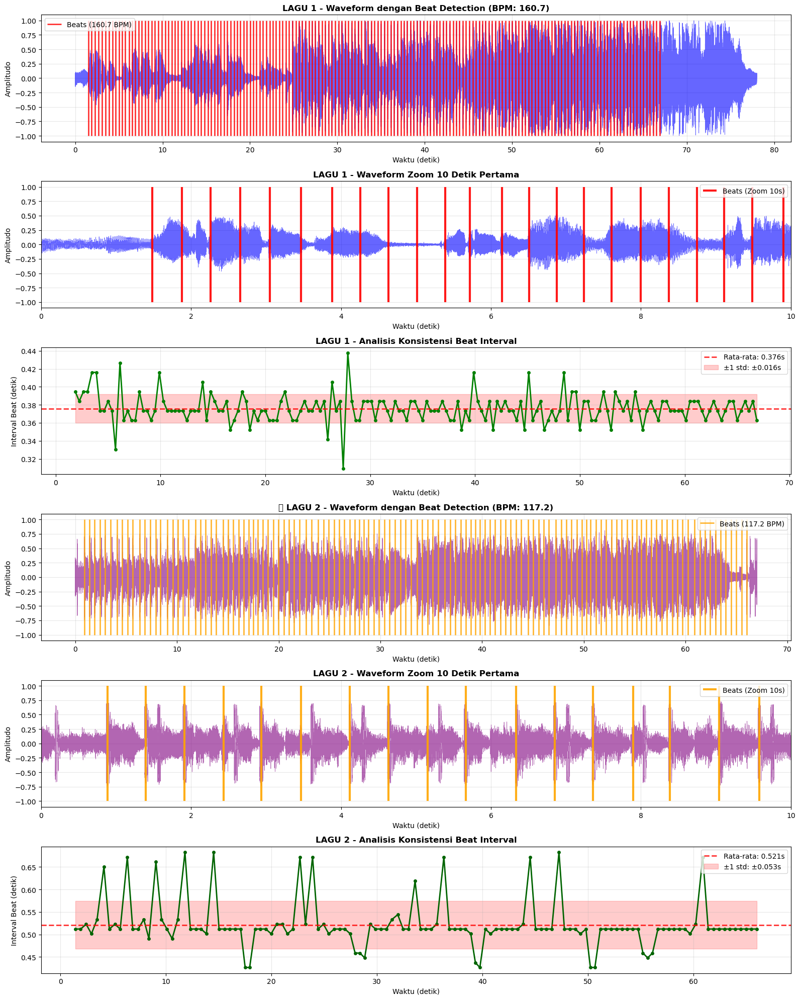


🎧 Audio Preview:

Lagu 1 (Original):



Lagu 2 (Original):


In [22]:
# Visualisasi Deteksi Tempo Lagu 1 dan Lagu 2
fig, axes = plt.subplots(6, 1, figsize=(16, 20))

# initial zoom data (10 detik pertama)
zoom_duration = 10
zoom_samples1 = int(zoom_duration * rate1)
zoom_samples2 = int(zoom_duration * rate2)

# Data zoom untuk Lagu 1
y_zoom1 = data1_cut[:zoom_samples1]
time_zoom1 = np.linspace(0, zoom_duration, zoom_samples1)
zoom_times1 = beats1_time[beats1_time <= zoom_duration]

# Data zoom untuk Lagu 2
y_zoom2 = data2_cut[:zoom_samples2]
time_zoom2 = np.linspace(0, zoom_duration, zoom_samples2)
zoom_times2 = beats2_time[beats2_time <= zoom_duration]

# LAGU 1
# 1. Waveform dengan beat markers - Lagu 1
axes[0].plot(np.linspace(0, len(data1_cut)/rate1, len(data1_cut)), data1_cut, alpha=0.6, color='blue', linewidth=0.5)
axes[0].vlines(beats1_time, -1, 1, color='red', alpha=0.8, linewidth=2, label=f'Beats ({tempo1[0]:.1f} BPM)')
axes[0].set_title(f'LAGU 1 - Waveform dengan Beat Detection (BPM: {tempo1[0]:.1f})', fontweight='bold', fontsize=12)
axes[0].set_xlabel('Waktu (detik)')
axes[0].set_ylabel('Amplitudo')
axes[0].legend()
axes[0].grid(True, alpha=0.3)

# 2. Waveform dengan beat markers (zoom 10 detik pertama) - Lagu 1
axes[1].plot(time_zoom1, y_zoom1, alpha=0.6, color='blue', linewidth=0.5)
axes[1].vlines(zoom_times1, -1, 1, color='red', alpha=0.9, linewidth=3, label=f'Beats (Zoom {zoom_duration}s)')
axes[1].set_title(f'LAGU 1 - Waveform Zoom {zoom_duration} Detik Pertama', fontweight='bold', fontsize=12)
axes[1].set_xlabel('Waktu (detik)')
axes[1].set_ylabel('Amplitudo')
axes[1].set_xlim(0, zoom_duration)
axes[1].legend()
axes[1].grid(True, alpha=0.3)

# 3. Beat interval analysis - Lagu 1
axes[2].plot(beats1_time[1:], beat_intervals1, 'o-', color='green', markersize=4, linewidth=2)
axes[2].axhline(y=avg_interval1, color='red', linestyle='--', alpha=0.8, linewidth=2, 
                   label=f'Rata-rata: {avg_interval1:.3f}s')
axes[2].fill_between(beats1_time[1:], avg_interval1 - interval_std1, avg_interval1 + interval_std1, 
                        alpha=0.2, color='red', label=f'±1 std: ±{interval_std1:.3f}s')
axes[2].set_title('LAGU 1 - Analisis Konsistensi Beat Interval', fontweight='bold', fontsize=12)
axes[2].set_xlabel('Waktu (detik)')
axes[2].set_ylabel('Interval Beat (detik)')
axes[2].legend()
axes[2].grid(True, alpha=0.3)

# LAGU 2
# 4. Waveform dengan beat markers - Lagu 2
axes[3].plot(np.linspace(0, len(data2_cut)/rate2, len(data2_cut)), data2_cut, alpha=0.6, color='purple', linewidth=0.5)
axes[3].vlines(beats2_time, -1, 1, color='orange', alpha=0.8, linewidth=2, label=f'Beats ({tempo2[0]:.1f} BPM)')
axes[3].set_title(f'🎵 LAGU 2 - Waveform dengan Beat Detection (BPM: {tempo2[0]:.1f})', fontweight='bold', fontsize=12)
axes[3].set_xlabel('Waktu (detik)')
axes[3].set_ylabel('Amplitudo')
axes[3].legend()
axes[3].grid(True, alpha=0.3)

# 5. Waveform dengan beat markers (zoom 10 detik pertama) - Lagu 2
axes[4].plot(time_zoom2, y_zoom2, alpha=0.6, color='purple', linewidth=0.5)
axes[4].vlines(zoom_times2, -1, 1, color='orange', alpha=0.9, linewidth=3, label=f'Beats (Zoom {zoom_duration}s)')
axes[4].set_title(f'LAGU 2 - Waveform Zoom {zoom_duration} Detik Pertama', fontweight='bold', fontsize=12)
axes[4].set_xlabel('Waktu (detik)')
axes[4].set_ylabel('Amplitudo')
axes[4].set_xlim(0, zoom_duration)
axes[4].legend()
axes[4].grid(True, alpha=0.3)

# 6. Beat interval analysis - Lagu 2
axes[5].plot(beats2_time[1:], beat_intervals2, 'o-', color='darkgreen', markersize=4, linewidth=2)
axes[5].axhline(y=avg_interval2, color='red', linestyle='--', alpha=0.8, linewidth=2, 
                   label=f'Rata-rata: {avg_interval2:.3f}s')
axes[5].fill_between(beats2_time[1:], avg_interval2 - interval_std2, avg_interval2 + interval_std2, 
                        alpha=0.2, color='red', label=f'±1 std: ±{interval_std2:.3f}s')
axes[5].set_title('LAGU 2 - Analisis Konsistensi Beat Interval', fontweight='bold', fontsize=12)
axes[5].set_xlabel('Waktu (detik)')
axes[5].set_ylabel('Interval Beat (detik)')
axes[5].legend()
axes[5].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Audio preview
print("\n🎧 Audio Preview:")
print("\nLagu 1 (Original):")
display(Audio(data1_cut, rate=rate1))

print("\nLagu 2 (Original):")
display(Audio(data2_cut, rate=rate2))


🎵 DETEKSI KUNCI LAGU 1
• Kunci terdeteksi: F# Minor
• Confidence: 0.469

🎵 DETEKSI KUNCI LAGU 2
• Kunci terdeteksi: F# Major
• Confidence: 0.696



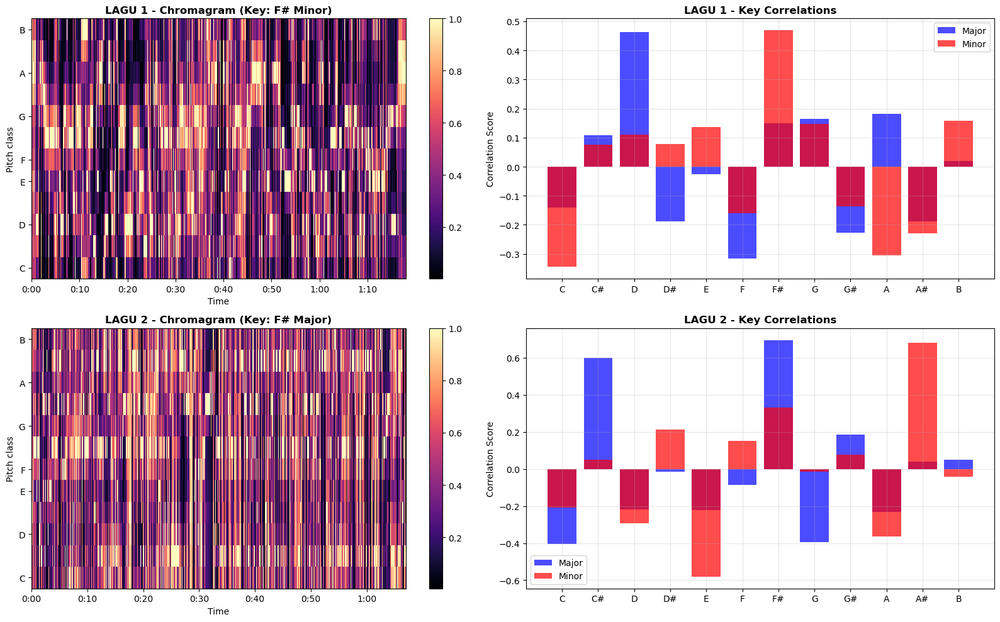

In [25]:
# Melakukan Deteksi Kunci untuk Lagu 1 dan Lagu 2

# Key templates (Krumhansl-Schmuckler profiles)
major_template = np.array([6.35, 2.23, 3.48, 2.33, 4.38, 4.09, 
                          2.52, 5.19, 2.39, 3.66, 2.29, 2.88])
minor_template = np.array([6.33, 2.68, 3.52, 5.38, 2.60, 3.53, 
                          2.54, 4.75, 3.98, 2.69, 3.34, 3.17])

# Normalize templates
major_template /= np.sum(major_template)
minor_template /= np.sum(minor_template)

# Key names
keys = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']

def detect_key(y, sr, song_name):
    """Deteksi kunci musik dari audio"""
    # Extract chroma features
    chroma = librosa.feature.chroma_stft(y=y, sr=sr)
    chroma_mean = np.mean(chroma, axis=1)
    
    # Calculate correlations for all keys
    major_scores = []
    minor_scores = []
    
    for i in range(12):
        # Rotate template for each key
        major_rotated = np.roll(major_template, i)
        minor_rotated = np.roll(minor_template, i)
        
        # Calculate correlation
        major_corr = np.corrcoef(chroma_mean, major_rotated)[0, 1]
        minor_corr = np.corrcoef(chroma_mean, minor_rotated)[0, 1]
        
        major_scores.append(major_corr)
        minor_scores.append(minor_corr)
    
    # Find best key
    best_major = np.argmax(major_scores)
    best_minor = np.argmax(minor_scores)
    
    if major_scores[best_major] > minor_scores[best_minor]:
        detected_key = f"{keys[best_major]} Major"
        confidence = major_scores[best_major]
    else:
        detected_key = f"{keys[best_minor]} Minor"
        confidence = minor_scores[best_minor]
    
    # Results
    print(f"🎵 DETEKSI KUNCI {song_name}")
    print(f"• Kunci terdeteksi: {detected_key}")
    print(f"• Confidence: {confidence:.3f}")
    print()
    
    return detected_key, confidence, chroma, major_scores, minor_scores

# Deteksi kunci Lagu 1
key1, conf1, chroma1, major_scores1, minor_scores1 = detect_key(data1_cut, rate1, "LAGU 1")

# Deteksi kunci Lagu 2
key2, conf2, chroma2, major_scores2, minor_scores2 = detect_key(data2_cut, rate2, "LAGU 2")

# Visualisasi
fig, axes = plt.subplots(2, 2, figsize=(16, 10))

# Lagu 1 - Chromagram
librosa.display.specshow(chroma1, y_axis='chroma', x_axis='time', ax=axes[0, 0], sr=rate1)
axes[0, 0].set_title(f'LAGU 1 - Chromagram (Key: {key1})', fontweight='bold')
plt.colorbar(axes[0, 0].collections[0], ax=axes[0, 0])

# Lagu 1 - Key correlations
x = np.arange(12)
axes[0, 1].bar(x, major_scores1, alpha=0.7, label='Major', color='blue')
axes[0, 1].bar(x, minor_scores1, alpha=0.7, label='Minor', color='red')
axes[0, 1].set_xticks(x)
axes[0, 1].set_xticklabels(keys)
axes[0, 1].set_title(f'LAGU 1 - Key Correlations', fontweight='bold')
axes[0, 1].set_ylabel('Correlation Score')
axes[0, 1].legend()
axes[0, 1].grid(True, alpha=0.3)

# Lagu 2 - Chromagram
librosa.display.specshow(chroma2, y_axis='chroma', x_axis='time', ax=axes[1, 0], sr=rate2)
axes[1, 0].set_title(f'LAGU 2 - Chromagram (Key: {key2})', fontweight='bold')
plt.colorbar(axes[1, 0].collections[0], ax=axes[1, 0])

# Lagu 2 - Key correlations
axes[1, 1].bar(x, major_scores2, alpha=0.7, label='Major', color='blue')
axes[1, 1].bar(x, minor_scores2, alpha=0.7, label='Minor', color='red')
axes[1, 1].set_xticks(x)
axes[1, 1].set_xticklabels(keys)
axes[1, 1].set_title(f'LAGU 2 - Key Correlations', fontweight='bold')
axes[1, 1].set_ylabel('Correlation Score')
axes[1, 1].legend()
axes[1, 1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()


## Refrensi
- Lagu 1 - [Youtube](https://www.youtube.com/watch?v=fQ3H3U6MzSE)
- Lagu 2 - [Youtube](https://www.youtube.com/watch?v=zDHOW9PdQYE)
- Convert Youtube to WAV - [Tuberipper](https://tuberipper.cc/63/save/wav)